In [ ]:

def calc_d_matrix(p_matrix):
    d_matrix = np.zeros((N,N,3))
    
    #dx = p_matrix[:, 0][:, np.newaxis] - p_matrix[:, 0] 
    #dx = d_matrix[:,:,0]
    d_matrix[:,:,0] = p_matrix[:, 0][:, np.newaxis] - p_matrix[:, 0] #inspired by chat gpt
    d_matrix[:,:,1] = p_matrix[:, 1][:, np.newaxis] - p_matrix[:, 1] 

    mask_more = d_matrix > box[0]/2
    d_matrix[mask_more] -= box[0]/2

    mask_less = d_matrix < -box[0]/2
    d_matrix[mask_less] += box[0]/2
    
    d_matrix[np.abs(d_matrix[:,:,0]) == box[0]/ 2] = 0
    d_matrix[np.abs(d_matrix[:,:,1]) == box[1]/ 2] = 0

    d_matrix[:,:, 2] = np.sqrt(d_matrix[:,:,0]**2 +  d_matrix[:,:,1]**2)

    d_matrix[:,:,1] = d_matrix[:,:,1] -2* np.tril(d_matrix[:,:,1], k = -1)

    return d_matrix
d_matrix = calc_d_matrix(p_matrix)

plt.imshow(d_matrix[:,:,2])
plt.xlabel('position x')
plt.ylabel('position y')
plt.colorbar().set_label('distance')
plt.show()

In [ ]:
def dist_mat_pbc(pos, box):
    """ Calculate the distance matrix in 2D taking periodic 
        boundary conditions (pbc) into account. 
        Code adapted from the one given in the tutorial. """
    # distance vector matrix NxNx2
    #pos = np.zeros((N, 2))
    D = np.abs(pos[np.newaxis, :, :] - pos[:, np.newaxis, :])
    # if distance larger than half the box width/height, the particles are closer
    # due to pbc -> the distance is the difference to the box width/height
    D[:, :, 0] = np.where( D[:, :, 0] > (0.5 * box[0]), np.abs(box[0] - D[:, :, 0]), D[:, :, 0])
    D[:, :, 1] = np.where( D[:, :, 1] > (0.5 * box[1]), np.abs(box[1] - D[:, :, 1]), D[:, :, 1])
    # summing over the last axis (so over x and y), resulting in NxN
    Dsqr = np.sum(D**2, axis=-1)
    return np.sqrt(Dsqr)  # taking the squareroot to get distance matrix

Implement	a	routine	with	which	you	can	generate	a	set	of	start	coordinates	for	
your	particle	system,	write	it	out	to	a	file,	and	read	it	in	again.	The	target	is	to	be	
albe	to	carry	out	minimizations	with	different	methods	while	starting	with	the	
same	set	of	initial coordinates.	

In [62]:

import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

import copy
import numpy as np
from numba import jit
import scipy as scy
import scipy.constants as const

import sys
import os

# Add the parent directory (project_folder) to the system path
sys.path.append(os.path.abspath(os.path.join(os.path.dirname('modules.py'), '..')))
from mylib.modules import  LJ_r ##cannot hand this in, because modules.py would need to be with it!

seed = np.random.randint(1,1e9)
rng = np.random.default_rng(seed)
print(seed)

575145419


In [ ]:

#test functionen nicht in classe als methoded aufnehmen!


class Particles:
    def __init__(self, r, m, N, pos, vel, acc):
        self.N = N
        self.r = r
        self.m = m
        self.pos= pos  #N,2
        self.vel = vel
        self.acc = acc
        

    def init_particles(): #andreas
    def init_2particles():  #andreas
    def pbc(self): #andreas
    def calc_d_matrix(self): #andreas  (N,N,3 array)
    def calc_f_matrix(self): #jakob
    def visualize(self): #andreas fct


class Simulation:
    def __init__(self,steps, particles: Particles):#intellisence vorschläge die vsc macht
        self.data_traj = np.zeros((particles.N, 4, steps+1))
        self.d_matrix = np.zeros((particles.N, particles.N, 2))
        self.particles = particles

    def verlet(self,):  #andreas

    

    def steepest_decent(self):  #jakob


class Analysis:
    def __init__(self,):
        self.E_pot = E_pot #1,N array
        self.E_kin = E_kin # 1,N array
       
    def calc_E_pot(self):  #jakob
    def calc_E_kin(self):   #kabob
    def calc_T(self):    #jakob
    def animate(self):    #andreas
    




    def __repr__(self):
        return str("This is a particle at %0.2f, %0.2f with v=%0.2f,%0.2f" % (self.x,self.y,self.vx,self.vy))

In [ ]:
particles = Particles()
sim = Simulation(particles)


In [ ]:
def pbc(p, box):  #andreas
    p.x = p.x % box[0]
    p.y = p.y % box[1]
    return p

In [ ]:
def init_2particles(p2,radius, mass, vel, box, x_pos1, x_pos2, y_pos1,y_pos2, show_plot = True):  #andreas
    vx = vy = ax = ay = ax_next = ay_next = 0
    p2.append(Particle(radius, mass, x_pos1, y_pos1, vx, vy, ax, ay, ax_next, ay_next))
    p2.append(Particle(radius, mass, x_pos2, y_pos2, vx, vy, ax, ay, ax_next, ay_next))
    x_pos_array = np.array([x_pos1, x_pos2])
    y_pos_array = np.array([y_pos1, y_pos2])
    r_matrix = calc_r_matrix(p2, 2, box)
    
    if show_plot == True:
        plt.hist2d(x_pos_array, y_pos_array, range=[[0, box[0]], [0, box[1]]], bins=100)
        plt.figtext(0.5, -0.1, f'distance between particles is: {r_matrix[0,1,2]}nm')
        plt.xlabel('position x')
        plt.ylabel('position y')
        plt.colorbar().set_label('occupancy')
        plt.show()

In [ ]:
def init_particles(p, N, radius, mass, vel, box , c12, c6,random = True, show_plot = True): #andreas
    angle = rng.uniform(0, 2 * np.pi, N)
    ax = ay = ax_next = ay_next = 0  #calc force here!

    if random == True:
        x_coords = np.random.uniform(0,box[0],N)
        y_coords = np.random.uniform(0,box[0],N)
        

        for i in range(N):
            x_pos = x_coords[i]
            y_pos = y_coords[i]
            vx = np.cos(angle[i]) * vel
            vy = np.sin(angle[i]) * vel
            p.append(Particle(radius, mass, x_pos, y_pos, vx, vy, ax, ay, ax_next, ay_next))
        r_matrix = calc_r_matrix(p,N,box)
        f_matrix = calc_f_matrix(r_matrix, N, c12, c6)
        for i in range(N):
            p[i].ax = np.sum(f_matrix[i,:,0])/p[i].m
            p[i].ay= np.sum(f_matrix[i,:,1])/p[i].m
    else:
        grid_x = int(np.sqrt(N))  #could also find next closest number , so that N gets spread up well!
        grid_y = int(np.ceil(N / grid_x))  #8
        x_spacing = box[0] / (grid_x + 1)
        y_spacing = box[1] / (grid_y + 1)

        x_coords = np.linspace(x_spacing, box[0], grid_x)
        y_coords = np.linspace(y_spacing, box[1], grid_y)
    
        for i in range(N):
            x_pos = x_coords[i % grid_x]
            y_pos = y_coords[i // grid_x]
            vx = np.cos(angle[i]) * vel
            vy = np.sin(angle[i]) * vel
            p.append(Particle(radius, mass, x_pos, y_pos, vx, vy, ax, ay, ax_next, ay_next))
        r_matrix = calc_r_matrix(p,N,box)
        f_matrix = calc_f_matrix(r_matrix, N, c12, c6)
        
        for i in range(N):
            p[i].ax = np.sum(f_matrix[i,:,0])/p[i].m
            p[i].ay= np.sum(f_matrix[i,:,1])/p[i].m

    x_pos_array = np.array([p_i.x for p_i in p])    #1,2,3
    y_pos_array = np.array([p_i.y for p_i in p])  #stays the same for the first particles, so we order particles going through the rows!!

    #1,2,3
    #4,5,6
    #7,8,9 is particles ordering!
    if show_plot == True:
        plt.hist2d(x_pos_array, y_pos_array, range=[[0, box[0]], [0, box[1]]], bins=100)
        plt.xlabel('position x')
        plt.ylabel('position y')
        plt.colorbar().set_label('occupancy')
        plt.show()
    return p

In [ ]:
def display_positions(p, box):   #andreas
    x_pos_array = np.array([p_i.x for p_i in p])    #1,2,3
    y_pos_array = np.array([p_i.y for p_i in p])  #stays the same for the first particles, so we order particles going through the rows!!

    #1,2,3
    #4,5,6
    #7,8,9 is particles ordering!

    plt.hist2d(x_pos_array, y_pos_array, range=[[0, box[0]], [0, box[1]]], bins=100)
    plt.xlabel('position x')
    plt.ylabel('position y')
    plt.colorbar().set_label('occupancy')
    plt.show()

In [ ]:

def calc_r_matrix(p, N, box):
    r_matrix = np.zeros((N,N,3))
    for i in range(N):
        for j in range(i+1, N):
            dx = p[j].x - p[i].x  #this assignment is chat gpt inspired
            dy = p[j].y - p[i].y
            
            if dx > box[0]/2:
                dx = dx- box[0]
            elif dx < -box[0]/2:
                dx = dx + box[0]
            elif abs(dx) == box[0]/2:
                dx = 0
            
            if dy > box[1]/2:
                dy = dy - box[1]
            elif dy < -box[1]/2:
                dy = dy + box[1]
            elif abs(dy) == box[1]/2:
                dy = 0

            r_matrix[i, j, 0] = dx
            r_matrix[i, j, 1] = dy
            r_matrix[i, j, 2] = np.sqrt(dx**2 + dy**2)

            # Symmetric assignments
            r_matrix[j, i, 0] = -dx
            r_matrix[j, i, 1] = -dy
            r_matrix[j, i, 2] = r_matrix[i, j, 2]

    return r_matrix
          

def calc_d_matrix(p_matrix):
    d_matrix = np.zeros((N,N,3))
    
    #dx = p_matrix[:, 0][:, np.newaxis] - p_matrix[:, 0] 
    #dx = d_matrix[:,:,0]
    d_matrix[:,:,0] = p_matrix[:, 0][:, np.newaxis] - p_matrix[:, 0] #inspired by chat gpt
    d_matrix[:,:,1] = p_matrix[:, 1][:, np.newaxis] - p_matrix[:, 1] 

    mask_more = d_matrix > box[0]/2
    d_matrix[mask_more] -= box[0]/2

    mask_less = d_matrix < -box[0]/2
    d_matrix[mask_less] += box[0]/2
    
    d_matrix[np.abs(d_matrix[:,:,0]) == box[0]/ 2] = 0
    d_matrix[np.abs(d_matrix[:,:,1]) == box[1]/ 2] = 0

    d_matrix[:,:, 2] = np.sqrt(d_matrix[:,:,0]**2 +  d_matrix[:,:,1]**2)

    d_matrix[:,:,1] = d_matrix[:,:,1] -2* np.tril(d_matrix[:,:,1], k = -1)

    return d_matrix
d_matrix = calc_d_matrix(p_matrix)

plt.imshow(d_matrix[:,:,2])
plt.xlabel('position x')
plt.ylabel('position y')
plt.colorbar().set_label('distance')
plt.show()

        







In [8]:
#@jit(nopython=True)  #functioniert!! aber nicht schneller!
def calc_f_matrix(r_matrix, N, c12, c6):

    f_matrix = np.zeros((N,N,2))  #is force of particle i<<<<s on particle j sum up column!
    
    for i in range(N): 
        for j in range(i+1,N):
            if r_matrix[i,j,2] == 0:
                continue
            f_matrix[i,j,0] = -((12 * c12 / (r_matrix[i,j,2]** 14)) - (6 * c6 / (r_matrix[i,j,2] ** 8))) * (r_matrix[i,j,0]) #x comp
            f_matrix[i,j,1] = -((12 * c12 / (r_matrix[i,j,2]** 14)) - (6 * c6 / (r_matrix[i,j,2] ** 8))) * (r_matrix[i,j,1])   #y componente!
            
            f_matrix[j,i,0] = -f_matrix[i,j,0]
            f_matrix[j,i,1] = -f_matrix[i,j,1]
           
    return f_matrix  


## Simulation

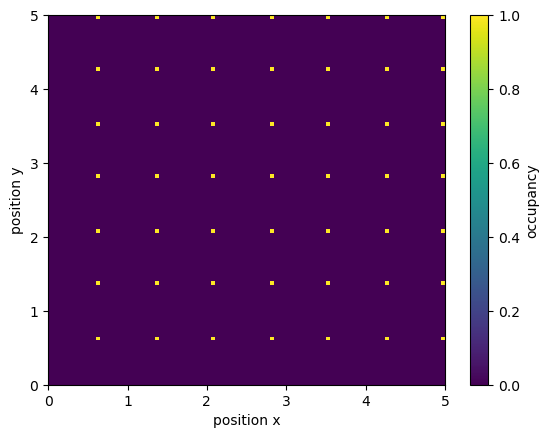

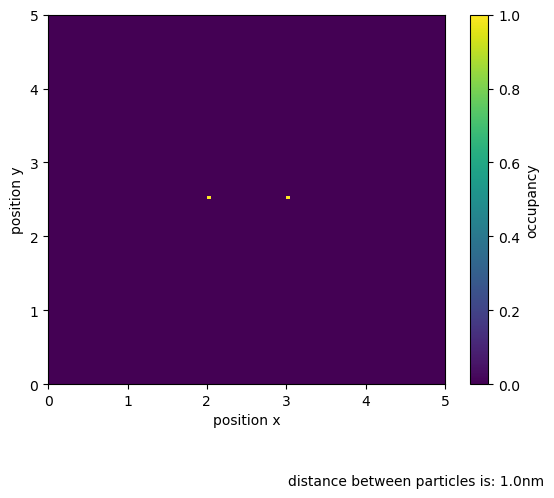

In [ ]:
c12 = 9.847044*10**-6 * 10**6   # g nm^14 /(mol ns^2)
c6 = 6.2647225*10**-3   *10**6  # g nm^8 /(mol ns^2)
dt = 2e-6 #ns
radius = 0.1 #nm

mass = 18  #g/mol
vel = 150  #nm/ns
                            
steps = 20000

box = [5, 5]  # Simulation box dimensions [x, y]
N = 49 # Number of particles
p = []
init_particles(p, N, radius, mass, vel, box , c12, c6,random = False, show_plot = True)

p2 = []
init_2particles(p2,radius, mass, vel, box, x_pos1 = 2*box[0]/5, x_pos2 = 3*box[0]/5, y_pos1 = box[1]/2,y_pos2 = box[1]/2, show_plot = True)


In [ ]:
def store_traj_step(data_traj,k,N):  #andreas
    for j in range(N):
        data_traj[j,:,k] = [p[j].x,p[j].y, p[j].vx, p[j].vy]

In [ ]:
data_traj = np.zeros((N,4,steps+1), dtype='object') #N, 4 , steps!
for k in range(steps):

    for j in range(N):
        p[j].x += p[j].vx * dt + 0.5 * p[j].ax * dt**2   #move  x_k+1
        p[j].y += p[j].vy * dt + 0.5 * p[j].ay * dt**2
        pbc(p[j], box)  #after moving the particles
    
    r_next_matrix = calc_r_matrix(p,N,box)  #r_next 
    f_next_matrix = calc_f_matrix(r_next_matrix, N, c12, c6)
        # no collisions, just lj potential repells unter 0.4 nm

    for j in range(N):  #resets j
        
        p[j].ax_next = np.sum(f_next_matrix[:,j,0])/p[j].m
        p[j].ay_next= np.sum(f_next_matrix[:,j,1])/p[j].m

        # Update velocity using Verlet velocity formula
        p[j].vx += 0.5 * (p[j].ax + p[j].ax_next) * dt
        p[j].vy += 0.5 * (p[j].ay + p[j].ay_next) * dt

        p[j].ax = p[j].ax_next
        p[j].ay = p[j].ay_next
    store_traj_step(data_traj, k,N)



In [12]:
fig, ax = plt.subplots()

ax.set_xlim((0, box[0]))
ax.set_ylim((0, box[1]))

plt.xlabel('position x')
plt.ylabel('position y')

dot, = ax.plot([], [], 'bo', ms=10.0)  #marker size

def init():
    dot.set_data([], [])
    return (dot,)

def animate(i):
    x = []
    y = []
    for k in range(N):
        x.append(data_traj[k,0,i])  #N,4,steps
        y.append(data_traj[k,1,i])
    dot.set_data(x, y)
    return (dot,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=steps, interval=20, blit=True)  #interval the smaller ,the smaller the delay between frams

HTML(anim.to_html5_video())

## doesnt show behavoir of flying away fast ist they hit! potential correct??

## data analysis!

In [13]:
#anim.save('particle_simulation.mp4', writer='ffmpeg', fps=30)
plt.close()

In [44]:
def calc_r_matrix_data(data_traj_t, N,box):  #data_traj[:,:,t] statt dim of p array, sollten gleich sein!!!
    r_matrix = np.zeros((N,N,3))
    for i in range(N):
        for j in range(i+1, N):
            dx = data_traj_t[j,0] - data_traj_t[i,0]   #this assignment is chat gpt inspired
            dy = data_traj_t[j,1] - data_traj_t[i,1]
            
            if dx > box[0]/2:
                dx = dx- box[0]
            elif dx < -box[0]/2:
                dx = dx + box[0]
            elif abs(dx) == box[0]/2:
                dx = 0
            
            if dy > box[1]/2:
                dy = dy - box[1]
            elif dy < -box[1]/2:
                dy = dy + box[1]
            elif abs(dy) == box[1]/2:
                dy = 0

            r_matrix[i, j, 0] = dx
            r_matrix[i, j, 1] = dy
            r_matrix[i, j, 2] = np.sqrt(dx**2 + dy**2)

            # Symmetric assignments
            r_matrix[j, i, 0] = -dx
            r_matrix[j, i, 1] = -dy
            r_matrix[j, i, 2] = r_matrix[i, j, 2]

    return r_matrix

In [57]:

def move_SD(p,f_matrix):
    for i in range(N):
        p[i].x = f_matrix[i,]

    return p

In [64]:
def E_pot(data_traj, t, N, c12, c6):  #e pot of all particles in one time step!
    E_pot = 0
    r_matrix = calc_r_matrix_data(data_traj[:,0:2,int(t)], N,box)
    for i in range(N):
        for j in range(i+1,N):
            if r_matrix[i,j,2] == 0:
                continue
            E_pot += c12/r_matrix[i,j,2]**12 - c6/r_matrix[i,j,2]**6  #want energy of all bonds from all bonds
    return E_pot

def E_kin(data_traj, N, t):
    E_kin = 0
    for i in range(N): #sum over all particles
        E_kin += 0.5* mass * (data_traj[i,2,int(t)]**2 + data_traj[i,3,int(t)]**2) #summing up the kinetic energy of the form of E = 0.5 * m * v^2
    return E_kin

#funtion for calculating the temperature
def Temp(E_kin_array, N):
        T = E_kin_array/(N*const.k) 
    return T

#N,4,steps

E_pot_array = np.zeros(steps)
for t in range(steps):
    E_pot_array[t] = E_pot(data_traj,t, N,c6, c12)
    
E_pot_array = E_pot_array[E_pot_array < 1e-4]
plt.plot(E_pot_array*10**3)
plt.ylabel('potential energy [J/mol]')
plt.show()

IndentationError: unindent does not match any outer indentation level (<tokenize>, line 20)

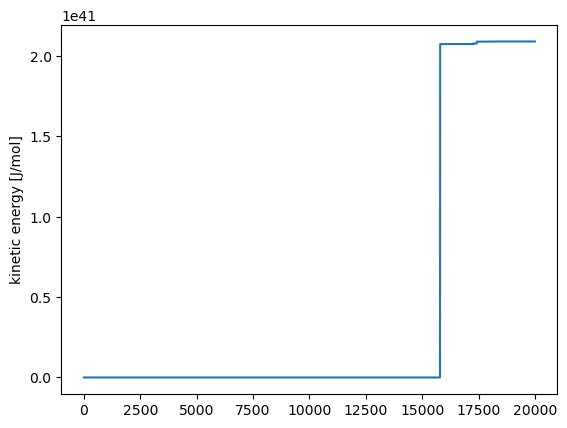

In [ ]:


E_kin_array = np.zeros(steps)

for t in range(steps):
    E_kin_array[t] = E_kin(data_traj, N, t) #in g*nm**2/mol/fs**2
    
plt.plot(E_kin_array*10**9)
plt.ylabel('kinetic energy [J/mol]')
plt.show()

In [ ]:
t = np.linspace(0,steps-1,steps)
Temp_list = np.zeros(steps)

for i in range(steps):
    Temp_list[i] = Temp(data_traj, N, t[i]) #in K/mol
    
plt.plot(t, Temp_list*10**9)
plt.ylabel('Temperature [K/mol]')
plt.show()


In [ ]:
def E_pot(data_traj, ):
    V_matrix = np.zeros((N,N, steps))
    r_V = np.zeros((steps))
    E = 
    for k in range(steps):
        r_V[k] = np.sqrt(data_traj[:,0,k]**2 + data_traj[:,1,k]**2)
    for i in range(N):
        for j in range(i+1, N):
            
            V_matrix[i,j, k] = ((C12 / (r_matrix[i,j,2]** 12)) - (C6 / (r_matrix[i,j,2] ** 6))) #x comp
    f_matrix = np.zeros((N,N,2))
    

    for i in range(N):
        for j in range(i+1,N):
            if r_matrix[i,j,2] == 0:
                continue
            E_pot_ges_t += C12/r_matrix[i,j,2]**12 - C6/r_matrix[i,j,2]**6
            # now one has x_k
            #is force of particle i<<<<s on particle j


    return pot